In [1]:
%load_ext autoreload
%autoreload 2

In [2]:
from saxs_data_processing import io, manipulate, target_comparison, subtract, sasview_fitting
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.backends.backend_pdf import PdfPages
import pandas as pd

## User parameter setup

List of all background files to use. Data loading function will find associated data files in the same directory as backgrounds.

In [3]:
background_fps = ['/mnt/c/Users/bgpel/My Drive/Research/PozzoResearchGroup/Stober_synthesis/SAXS_data/2024_10_05_StoberRandomCampaignV2/03210_B9-T1_Ethanol_background__000.dat',
                  '/mnt/c/Users/bgpel/My Drive/Research/PozzoResearchGroup/Stober_synthesis/SAXS_data/2024_10_07_randomcampaignV3/data/03218_D1-T1_Ethanol_background_1_000.dat',
                  '/mnt/c/Users/bgpel/My Drive/Research/PozzoResearchGroup/Stober_synthesis/SAXS_data/2024_10_11_randomV3_round2/03289_H6-T2_EtOH_background_1_000.dat',
                  '/mnt/c/Users/bgpel/My Drive/Research/PozzoResearchGroup/Stober_synthesis/SAXS_data/2024_10_15_Highlights_replicates/03357_D5-T2_Background_1_EtOH_000.dat',
                  '/mnt/c/Users/bgpel/My Drive/Research/PozzoResearchGroup/Stober_synthesis/SAXS_data/2024_10_17_randomBaselineV4/data/03439_C1-T2_EtOH_1_000.dat',
                  '/mnt/c/Users/bgpel/My Drive/Research/PozzoResearchGroup/Stober_synthesis/SAXS_data/2024_11_05_optimizationRound1/03533_F9-T1_Ethanol_background_1_000.dat',
                  '/mnt/c/Users/bgpel/My Drive/Research/PozzoResearchGroup/Stober_synthesis/SAXS_data/2024_11_12_optimizationRound2/data/03619_B11-T2_Ethanol_background_1_000.dat',
                  '/mnt/c/Users/bgpel/My Drive/Research/PozzoResearchGroup/Stober_synthesis/SAXS_data/2024_11_15_optimizationRound3/03644_B9-T2_Ethanol_background_1_000.dat',
                  '/mnt/c/Users/bgpel/My Drive/Research/PozzoResearchGroup/Stober_synthesis/SAXS_data/2024_11_18_optimizationRound4/03667_E11-T2__Ethanol_background_1__000.dat']

In [4]:
previous_result_df = pd.read_csv('../2024_11_04_OptimizationRound1/amplitude_phase_results_11_11_24.csv')

Select q ranges. Right now this relies on manual q range selection to a certain extent. We subtract background and fit the spline on a larger q-range, then evaluate the spline on a subset of the larger q range to avoid spline edge effects.

In [5]:
# q range to consider up to and including spline fit step
q_min_subtract = 0.002
q_max_subtract = 0.035

# q range to interpolate spline fit on and perform distance metric calculation with
q_min_spl = 0.003
q_max_spl = 0.03
n_interpolate_gridpts = 1001 # number of grid points to interpolate q on.

Select target particle parameters. Target is spherical particles with radius r and polydispersity pdi

In [6]:
target_r_nm = 60
target_r_angs = target_r_nm*10
target_pdi = 0.08
sld_silica = 8.575
sld_etoh = 9.611

Set processing and optimization parameters for distance calculation

In [7]:
# SavGol denoise filter parameters
savgol_n = 15
savgol_order = 3
# minimum data length - data with less than ~100 data points is due to valid data selection step in subtraction and is likley too noisy to do anything with.
min_data_len = 100

# spline fit parameters
s = 0.05
k = 3

#scale parameters
n_avg = 100

# Amplitude-phase distance parameters
optim = "DP"
grid_dim = 10

## ######################## STOP: Don't touch anything below here \#############################


## Load data

In [8]:
sample_data, uuid2bkg, data_fps = io.load_biocube_data_with_background(background_fps, 24)

/home/bgpelkie/Code/saxs_data_processing/src/saxs_data_processing/io.py:150: UserWarning: Duplicate UUID found for b8953350-d5ad-4c99-b929-ebfe8febd0df. Check your file naming
  warnings.warn(
/home/bgpelkie/Code/saxs_data_processing/src/saxs_data_processing/io.py:150: UserWarning: Duplicate UUID found for 0ec4dd81-7487-4689-96b9-b0f646a2047d. Check your file naming
  warnings.warn(
/home/bgpelkie/Code/saxs_data_processing/src/saxs_data_processing/io.py:150: UserWarning: Duplicate UUID found for ea0d2ca6-8818-45f8-b5e3-04858133284a. Check your file naming
  warnings.warn(
/home/bgpelkie/Code/saxs_data_processing/src/saxs_data_processing/io.py:150: UserWarning: Duplicate UUID found for 08189d6c-3d71-412d-bdd8-9aec48c0b3a7. Check your file naming
  warnings.warn(
/home/bgpelkie/Code/saxs_data_processing/src/saxs_data_processing/io.py:150: UserWarning: Duplicate UUID found for 1468528a-c926-4cdf-8982-dc31a2cc397b. Check your file naming
  warnings.warn(


In [9]:
len(data_fps)

200

## Calculate target scattering

In [10]:
q_grid = np.linspace(np.log10(q_min_spl), np.log10(q_max_spl), n_interpolate_gridpts)

q_grid_nonlog = 10**q_grid
target_I = target_comparison.target_intensities(q_grid_nonlog, target_r_angs, target_pdi, sld_silica, sld_etoh)
target_I = np.log10(target_I)

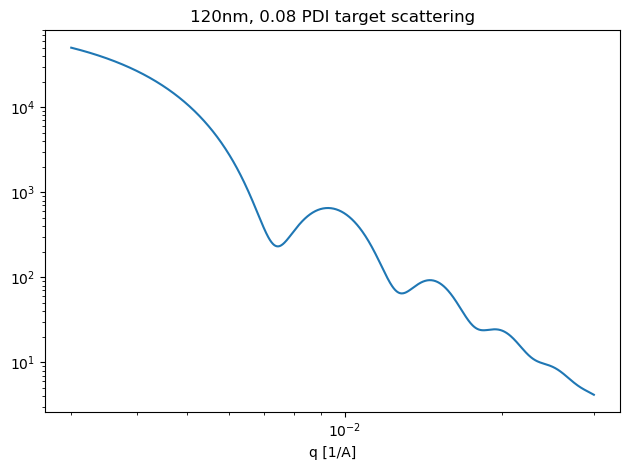

In [11]:
fig, ax = plt.subplots()
ax.loglog(10**q_grid, 10**target_I)
ax.set_xlabel('q [1/A]')
ax.set_title('120nm, 0.08 PDI target scattering')
plt.tight_layout()
plt.savefig('target_profile_120nm.png', dpi = 300)

a6ee3a08-02cd-4703-9d6c-3721dad590c8


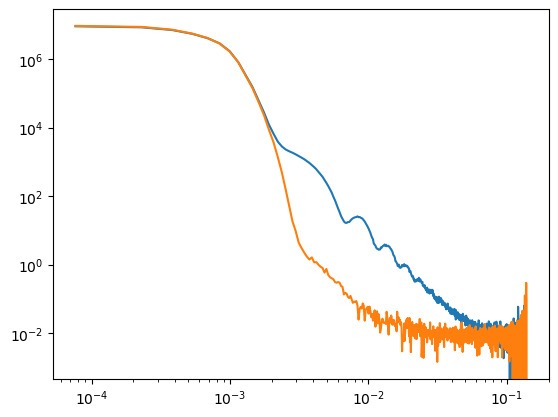

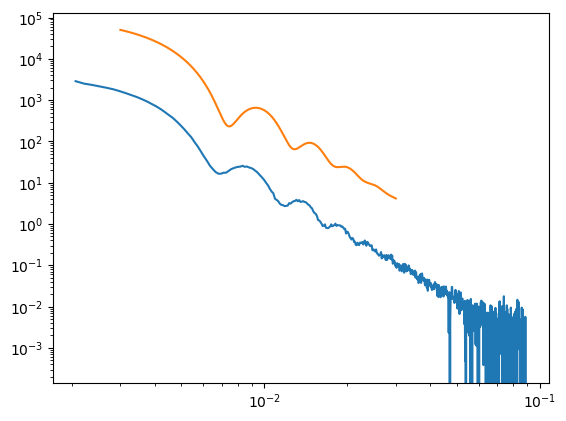

In [14]:
uuid_val = 'a6ee3a08-02cd-4703-9d6c-3721dad590c8'
entry = sample_data[uuid_val]

print(uuid_val)
bkg = uuid2bkg[uuid_val]

ratio_run = manipulate.ratio_running_average(entry[0]['I'], bkg[0]['I'])

subtracted = subtract.chop_subtract(entry[0], bkg[0], hiq_thresh=1)

fig, ax = plt.subplots()
ax.loglog(entry[0]['q'], entry[0]['I'])
ax.loglog(bkg[0]['q'], bkg[0]['I'])

fig, ax = plt.subplots()
if subtracted is not None:
    ax.loglog(subtracted['q'], subtracted['I'])
    ax.loglog(10**q_grid, 10**target_I)
else:
    ax.text(1,1, 'failed')

## Run full processing pipeline

0: 4bec4e18-80bb-44d9-8508-cc464f14b287
1: a180d359-a229-4b3e-a615-2991fd549f42
2: 3584700a-8b01-4e59-a53a-1300fd3fac0a
3: 0e6edb88-77c3-4984-a38d-198341bba9e1
4: 68831f53-4a51-4f12-b385-10c50c8fab46
5: fed3ab35-04e9-4916-8527-8627191a3bdc
6: 32ec16b1-c5b5-4d8b-b396-cd1ad4b740d9
7: a4d8a8f6-2654-490f-b14a-02d3fb1f94b2
8: 770a433d-0480-4cee-bf12-ce066c24db55
9: 41414be7-3e27-4b4d-b70e-e31d54a733d3
10: 6b50a94f-b7f2-402e-a210-e89f507b8861
11: fa1dfc55-e5e0-4514-a66a-e29a5351518a
12: ef17f542-90a3-44a8-a6b8-acb920953fab
13: 23850c30-c572-41ad-abf0-7e1bd4fa7397
14: 4ab46dcc-3395-4e7b-bb87-52e805e12abb
15: 657e707f-abc9-4f86-ae1e-9e59efb6e1f9
16: 96ef6012-d812-4975-8b77-8ed7e78669fb
17: e0368e49-ecc3-4ebf-9a19-4e942c829517
18: d03dab18-5712-44f7-9334-14047212632e
19: 4d5fd07b-987b-49df-b4ba-54d2a337d945
20: 6abcfcc8-cf8d-4a5e-a92f-f3afd8023fbd
21: 8559907a-1b27-4673-ae0e-602b83d86deb
22: b683d769-9cd7-454a-b546-4e86afe5e3f4
23: a6974af8-5b2d-431a-94df-d35c0be3ee54
24: 81f8f6c2-0e42-4680-bc1

/tmp/ipykernel_52474/898204095.py:15: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig, ax = plt.subplots()


25: f5e32498-0689-4e74-9a45-9c17edf776b9
26: 1c809d50-4605-4865-aa13-13649203ede8
27: fe8e4a28-cb6b-4396-adc3-a51f49838d54
28: 89b8593e-8436-4dfb-8430-1367d273cbc2
29: 403cbac3-a2e0-44f0-aca4-9313b8775a4e
30: 47d95862-b511-4a42-b8b1-961b605f26a3
31: 649ddf37-37fe-4a30-896b-010286133a28
32: a9d67fc5-2e59-4f51-a904-9cac957c9e73
33: 5d67ff81-9548-4a2f-9496-5d3c3c25b3eb
34: 289532b3-a4c8-4db7-93ff-9edc14d5d2c8
35: 43cd6089-f940-463f-bd40-a1f2bf168f67
36: fedab157-3d87-4f8b-b09b-590c966aa0ba
37: 48117328-d486-4f9f-96ab-b0034fe30cd5
38: 2027f32f-4921-4edd-95bb-849ab8220e8c
39: 1e52819b-5c95-48c2-8f70-d460a28eff49
40: ecc20fb9-daca-4f65-97ce-f1329696f7ec
41: f59733f7-c03c-4712-934e-fb6ea464b604
42: c2755e87-75e2-48c6-b27a-739971d1775c
43: 2a988138-57f5-40bf-851c-3df09f642f05
44: 0d339e3d-c04d-4f61-8cb0-2fd1f18006e9
45: 320cdd85-691d-48fb-9eac-d27b2fc5e5f5
46: a9ad98c9-82d7-4c69-851e-56ddb16bd5f5
47: bf04b495-3291-4508-a497-e6d96dc52362
48: f5458994-6b3e-4176-9427-7cef2bb6c7d5
49: 3ae01d8c-675

/home/bgpelkie/Code/saxs_data_processing/src/saxs_data_processing/subtract.py:137: UserWarning: Insufficient data points in q range with scattering. Check data quality
  warnings.warn(


119: 759bc1ef-f128-4db0-afec-489804bd5a62
120: f9b8246e-8b80-4955-9560-ada457bad27c
121: 56faa977-e163-444a-9156-e2fa4f7fe338
122: da8a1479-69d0-45be-b579-65c7a1dfa21b
123: a20c37f0-5b38-4a7c-bee3-d0d3d116c9e0
124: c0c257a6-ec89-4274-8d2a-38b479f2eece
125: 0ec4dd81-7487-4689-96b9-b0f646a2047d
126: ab43267e-6f46-4c9a-bc6a-ba6240fcb2fb
127: 23709b8a-dfbe-4f00-b9a7-644344ee10e2
128: 74579cb8-62f3-4d9e-8f66-6ca76a8ff53a
129: bfcf29cb-db74-40a1-9d27-911985c3f28f
130: defeadd7-5618-448a-bc01-6cf057fbe1ac
131: 81c548b0-7ef9-4ff0-b4e6-8977a3bb8ae4
132: 82d46018-8a24-4bb2-92b6-b4626d334344
133: ea0d2ca6-8818-45f8-b5e3-04858133284a
134: a3e0413e-4e1b-4f07-930b-690692b49c03
135: 12720234-74cc-4a1a-9cdc-cad646138159
136: 86790201-b18a-4f73-907d-61e0d3d0c114
137: 8d373b7d-c3a9-4148-8bcd-46021e36cb01
138: be0d7554-70c4-4a1f-a312-eea5e9ae1e45
139: 6791de91-caa6-4665-b50a-a0fcbadffcab
140: 131f3c99-0c3f-430d-880c-effef7248f1f
141: 3988b456-0f05-4af3-af65-7da9eab0ee6c
142: 9184744f-b57b-466e-ac26-2628b

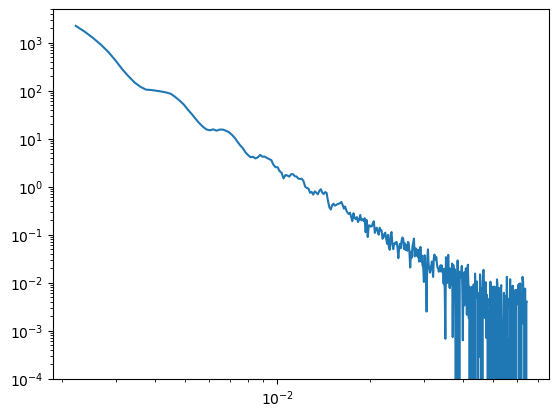

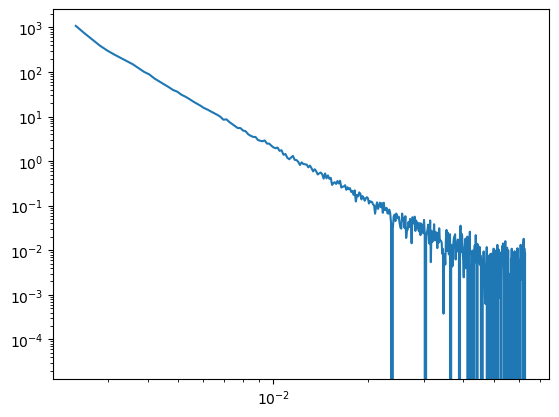

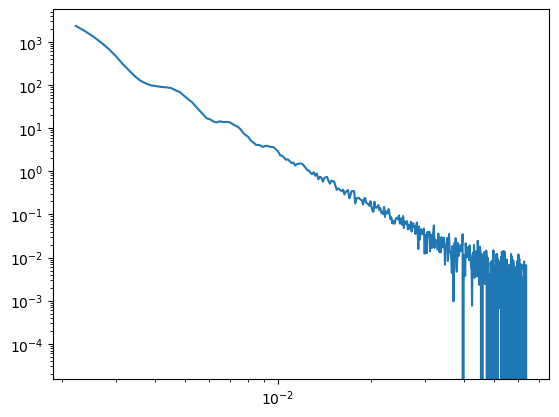

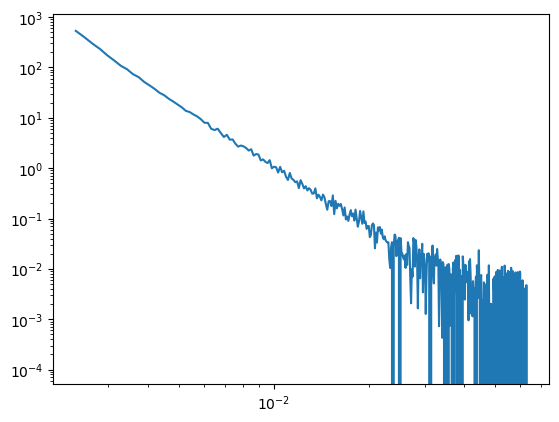

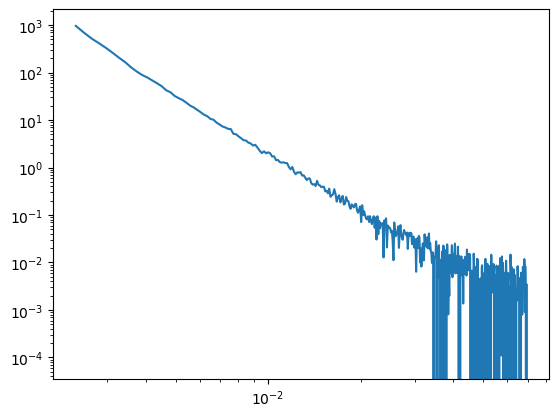

...

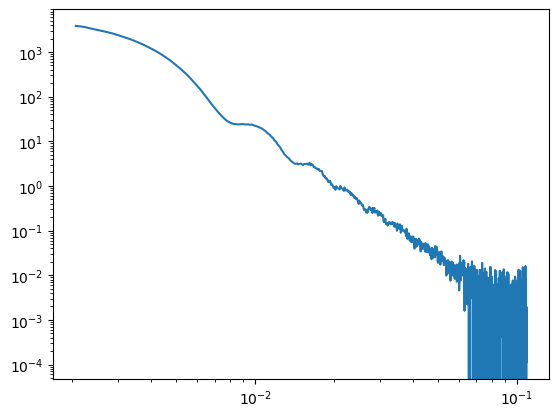

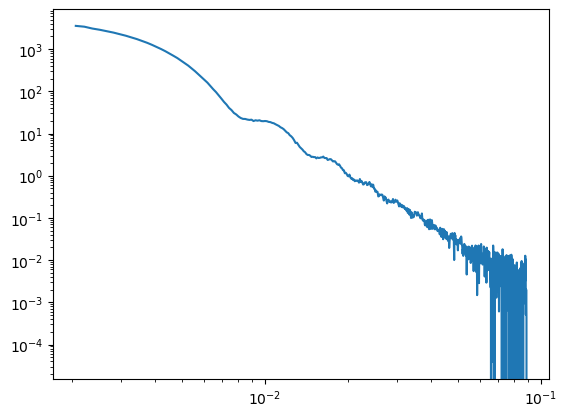

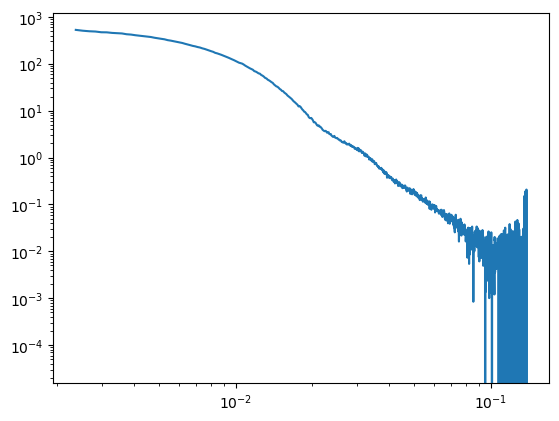

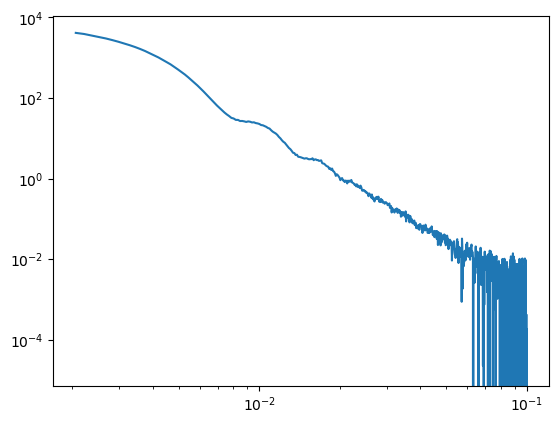

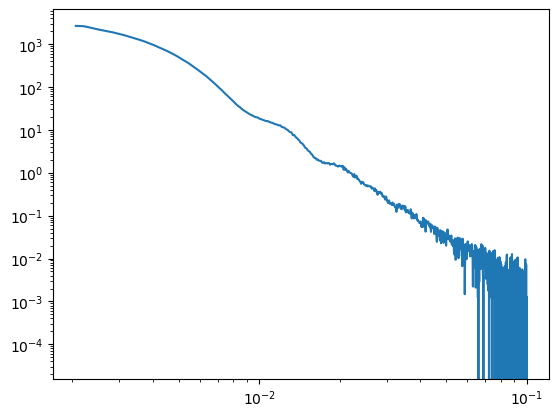

In [15]:
# subtract things for Kiran
processing_dataset = {}
counter = 0
for uuid_val, data_val in sample_data.items():
    print(f'{counter}: {uuid_val}')
    counter += 1
    meas_entry = {}
    meas_entry['original_data'] = data_val[0]
    background = uuid2bkg[uuid_val]
    meas_entry['background'] = background[0]
    # 1. Subtract background and select q range
    subtracted = subtract.chop_subtract(data_val[0], background[0], hiq_thresh=1)

    if subtracted is not None:
        fig, ax = plt.subplots()
        plt.loglog(subtracted['q'], subtracted['I'])
        #io.write_dat(subtracted, data_val[1], f'../../subtracted_data_kiran/{uuid_val}.dat')

In [18]:
processing_dataset = {}
counter = 0
for uuid_val, data_val in sample_data.items():
    if uuid_val == 'a6ee3a08-02cd-4703-9d6c-3721dad590c8': 
        print(f'{counter}: {uuid_val}')
        counter += 1
        meas_entry = {}
        meas_entry['original_data'] = data_val[0]
        background = uuid2bkg[uuid_val]
        meas_entry['background'] = background[0]
        # 1. Subtract background and select q range
        subtracted = subtract.chop_subtract(data_val[0], background[0], hiq_thresh=1)
        
        if subtracted is None:
            # if subtract returned None, data has issues and we are done with this sample
            meas_entry['status'] = 'failed'
            meas_entry['failure_point'] = 'background_subtraction'
            processing_dataset[uuid_val] = meas_entry
            print(f'Sample {uuid_val} failed at background subtraction')
            continue
            
        else:
            # q range selection
            subtracted = subtracted[subtracted['q'] < q_max_subtract]
            subtracted = subtracted[~subtracted['I'].isna()]
            subtracted = subtracted[subtracted['I'] > 0] # drop negative values 
            # screen on dataset length
            if len(subtracted) < min_data_len:
                meas_entry['status'] = 'failed'
                meas_entry['failure_point'] = 'subtracted_data_length'
                processing_dataset[uuid_val] = meas_entry
                print(f'Sample {uuid_val} failed due to data length')
                continue
            else:
                meas_entry['subtracted_clipped'] = subtracted
                meas_entry['status'] = 'valid'
                processing_dataset[uuid_val] = meas_entry
    
    
        # 2. Convert everything into log10 space
        q_log = np.log10(subtracted['q'].to_numpy())
        I_log = np.log10(subtracted['I'].to_numpy())
    
        meas_entry['q_log'] = q_log
        meas_entry['I_log'] = I_log
        
        # 3. denoise filter on intensity
        
        I_savgol = manipulate.denoise_intensity(I_log, savgol_n = savgol_n, savgol_order = savgol_order)
    
        meas_entry['I_savgol'] = I_savgol
    
        # 4. Spline fit and interpolate
        I_spline = manipulate.fit_interpolate_spline(q_log, I_savgol, q_grid, s = s, k = k)
        
        meas_entry['I_spline'] = I_spline
    
        # 5. scale onto target
        I_scaled = manipulate.scale_intensity_highqavg(I_spline, target_I, n_avg = n_avg)
    
        meas_entry['I_scaled'] = I_scaled
    
        #6. Calculate AP distance
    
        amplitude, phase = target_comparison.ap_distance(q_grid, I_scaled, target_I, optim = optim, grid_dim = grid_dim)
    
        ap_sum = amplitude + phase
    
        meas_entry['amplitude_distance'] = amplitude
        meas_entry['phase_distance'] = phase
        meas_entry['ap_sum_distance'] = ap_sum
    
        processing_dataset[uuid_val] = meas_entry
        

0: a6ee3a08-02cd-4703-9d6c-3721dad590c8


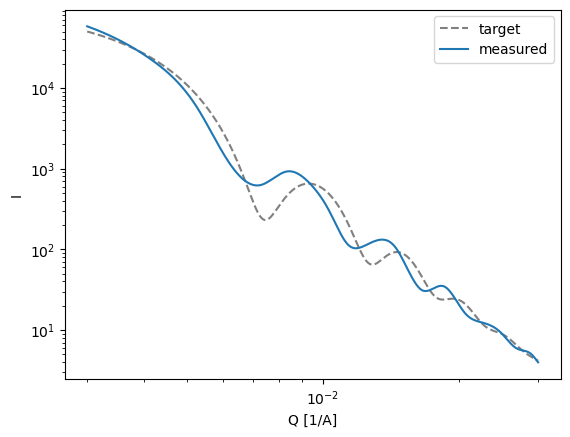

In [48]:
data = processing_dataset['a6ee3a08-02cd-4703-9d6c-3721dad590c8']
fig, ax = plt.subplots()

ax.loglog(10**q_grid, 10**target_I, color = 'gray', label = 'target', ls = '--')
ax.loglog(10**q_grid, 10**data['I_scaled'], label = 'measured')
ax.set_xlabel('Q [1/A]')
ax.set_ylabel('I')
ax.legend()
plt.savefig('Optimround1_120nm_best.png', dpi = 300)

### Sanity check subtraction

770a433d-0480-4cee-bf12-ce066c24db55
fed3ab35-04e9-4916-8527-8627191a3bdc
4ab46dcc-3395-4e7b-bb87-52e805e12abb
23850c30-c572-41ad-abf0-7e1bd4fa7397
96ef6012-d812-4975-8b77-8ed7e78669fb
d03dab18-5712-44f7-9334-14047212632e
failed at  subtracted_data_length
a180d359-a229-4b3e-a615-2991fd549f42
ef17f542-90a3-44a8-a6b8-acb920953fab
e0368e49-ecc3-4ebf-9a19-4e942c829517
4d5fd07b-987b-49df-b4ba-54d2a337d945
failed at  subtracted_data_length
6b50a94f-b7f2-402e-a210-e89f507b8861
657e707f-abc9-4f86-ae1e-9e59efb6e1f9
failed at  subtracted_data_length
0e6edb88-77c3-4984-a38d-198341bba9e1
32ec16b1-c5b5-4d8b-b396-cd1ad4b740d9
a4d8a8f6-2654-490f-b14a-02d3fb1f94b2
3584700a-8b01-4e59-a53a-1300fd3fac0a
fa1dfc55-e5e0-4514-a66a-e29a5351518a
68831f53-4a51-4f12-b385-10c50c8fab46
4bec4e18-80bb-44d9-8508-cc464f14b287
41414be7-3e27-4b4d-b70e-e31d54a733d3
81f8f6c2-0e42-4680-bc11-c0be02bfd641
47d95862-b511-4a42-b8b1-961b605f26a3
6abcfcc8-cf8d-4a5e-a92f-f3afd8023fbd
89b8593e-8436-4dfb-8430-1367d273cbc2
8559907a-1

/tmp/ipykernel_13591/1424264336.py:11: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig, ax = plt.subplots()


f5e32498-0689-4e74-9a45-9c17edf776b9
403cbac3-a2e0-44f0-aca4-9313b8775a4e
a6974af8-5b2d-431a-94df-d35c0be3ee54
289532b3-a4c8-4db7-93ff-9edc14d5d2c8
1edc0740-a22f-4216-bd49-d80627b2fb63
1e52819b-5c95-48c2-8f70-d460a28eff49
0d339e3d-c04d-4f61-8cb0-2fd1f18006e9
a9ad98c9-82d7-4c69-851e-56ddb16bd5f5
48117328-d486-4f9f-96ab-b0034fe30cd5
c2755e87-75e2-48c6-b27a-739971d1775c
fedab157-3d87-4f8b-b09b-590c966aa0ba
f59733f7-c03c-4712-934e-fb6ea464b604
ecc20fb9-daca-4f65-97ce-f1329696f7ec
3ae01d8c-6757-4aa4-8701-a4f231f6a81c
48c60f84-a45b-4017-9430-12b3234fdc0e
2a0a2e87-67a7-401a-943d-423159a4a939
43cd6089-f940-463f-bd40-a1f2bf168f67
9b9c349b-8f9d-4f0c-829c-fa99e67e90fb
ff3ac045-3c39-4fb0-b2c9-bf69d7600548
failed at  subtracted_data_length
5452fa4a-b64c-46d7-ace2-bf1b31afc3b3
failed at  subtracted_data_length
9aed2e5c-7127-46bd-8331-51407d127d8f
5edc0763-1f2c-44f2-bf68-db785ae258b0
320cdd85-691d-48fb-9eac-d27b2fc5e5f5
bf04b495-3291-4508-a497-e6d96dc52362
649ddf37-37fe-4a30-896b-010286133a28
failed 

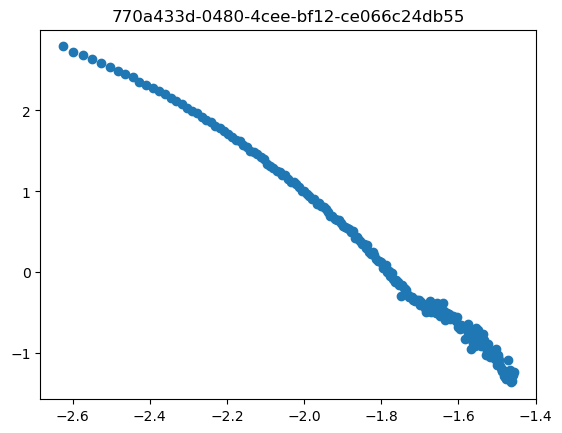

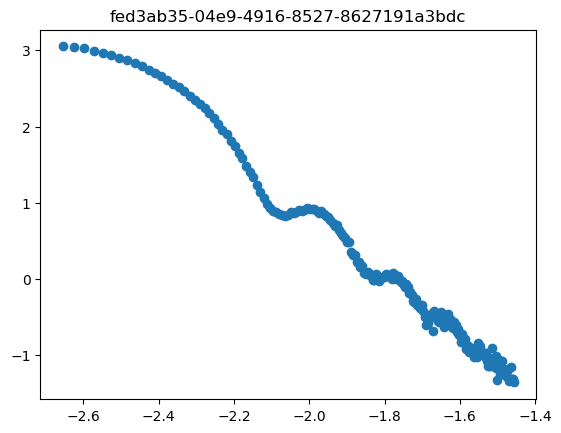

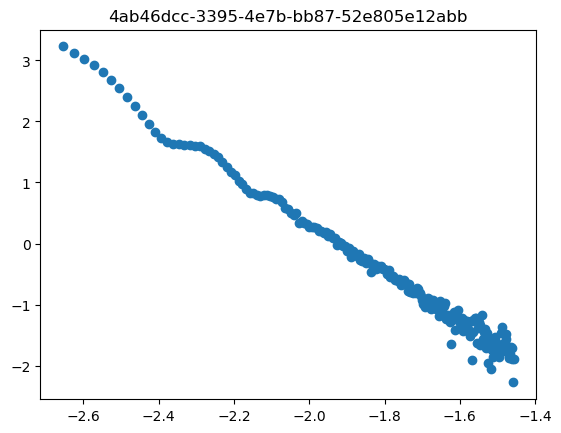

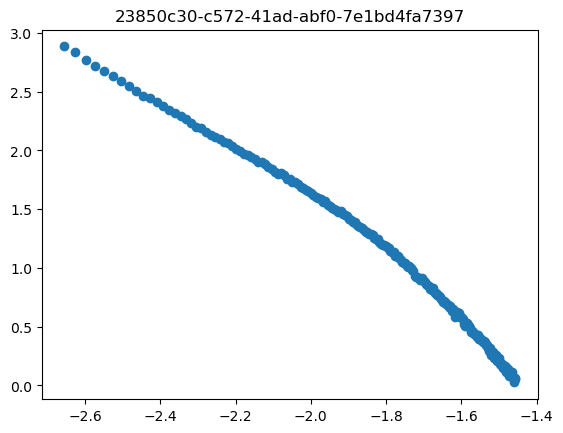

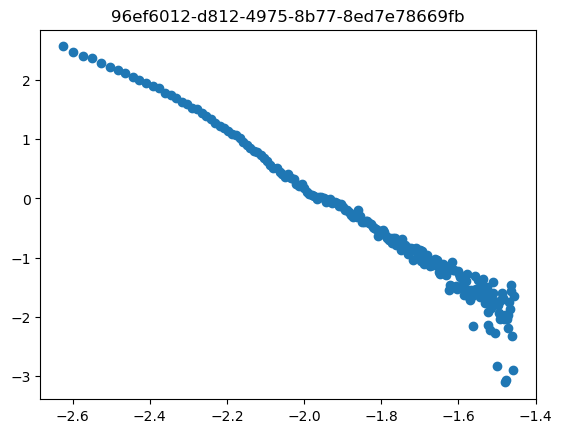

...

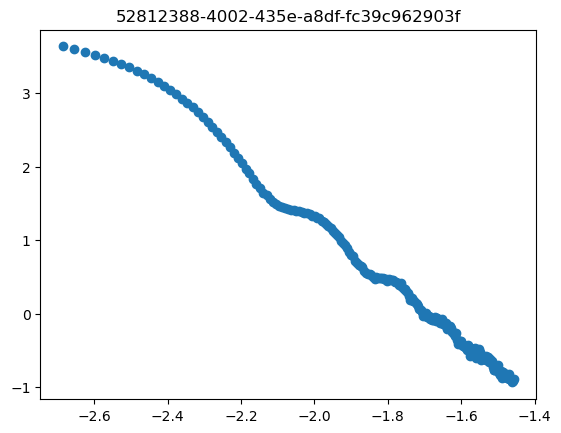

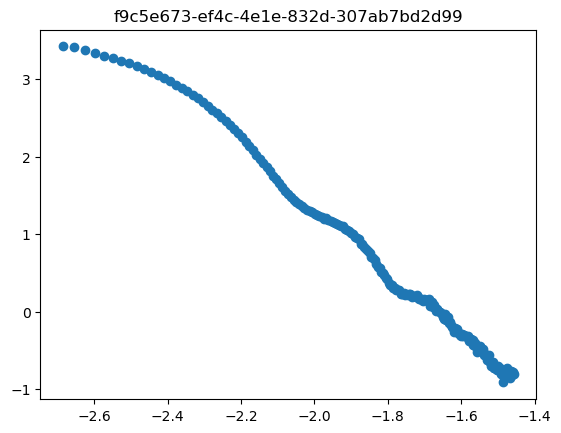

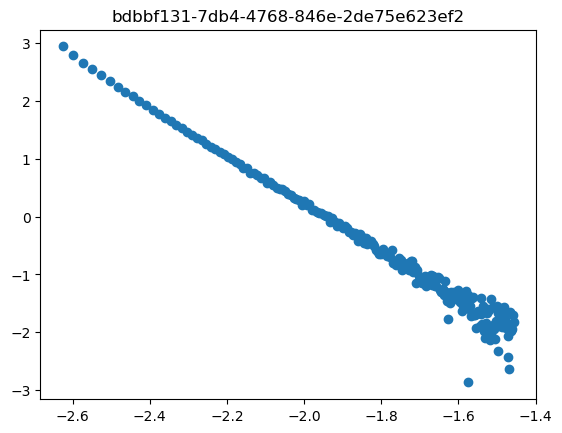

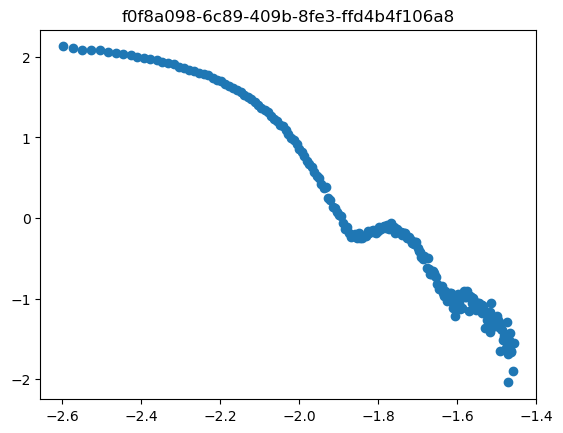

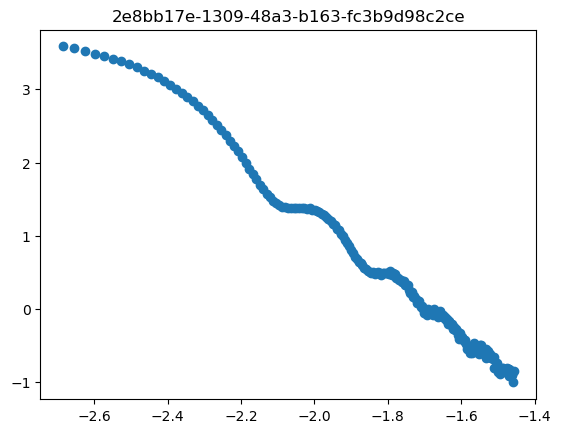

In [14]:
for uuid_val, entry in processing_dataset.items():
    print(uuid_val)
    try:
        status = entry['status']
        if status == 'failed':
            print('failed at ', entry['failure_point'])
            continue
        else:
            raise KeyError
    except KeyError:
        fig, ax = plt.subplots()
    
        I_subtracted = entry['I_log']
        q = entry['q_log']
    
        ax.scatter(q, I_subtracted)
        ax.set_title(uuid_val)

## Sanity check spline fit

/tmp/ipykernel_13591/3859189070.py:9: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig, ax = plt.subplots()


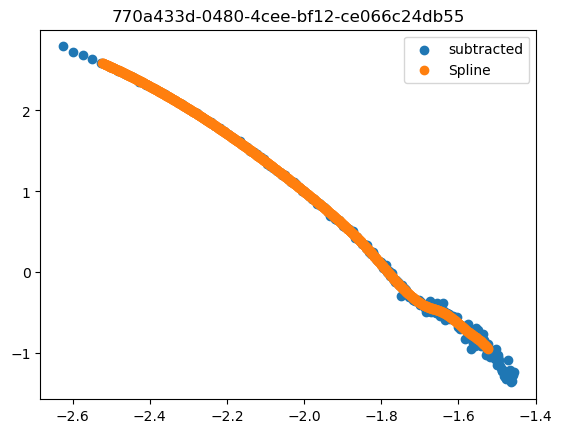

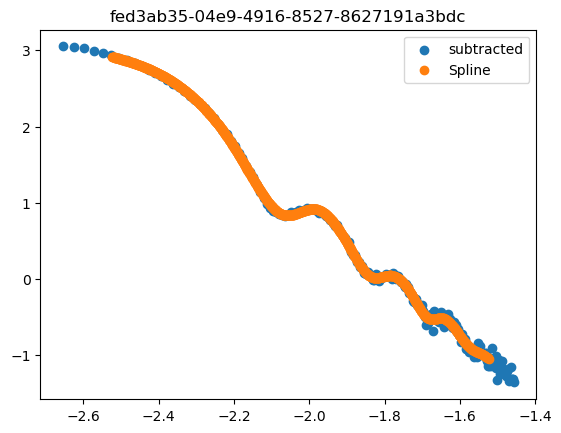

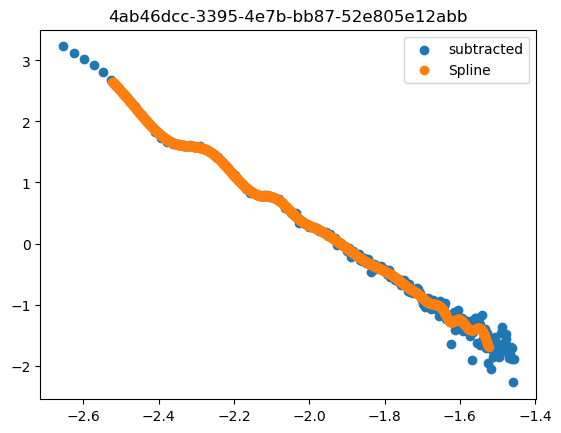

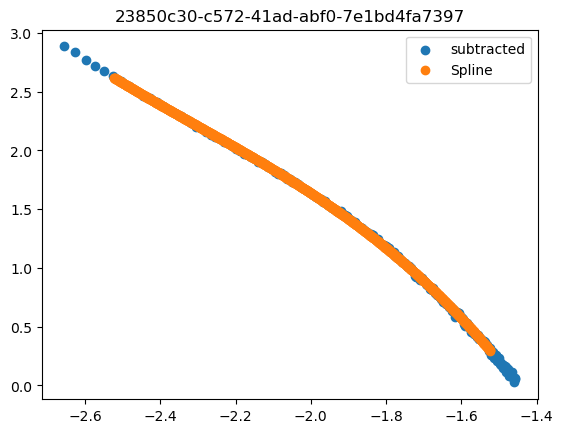

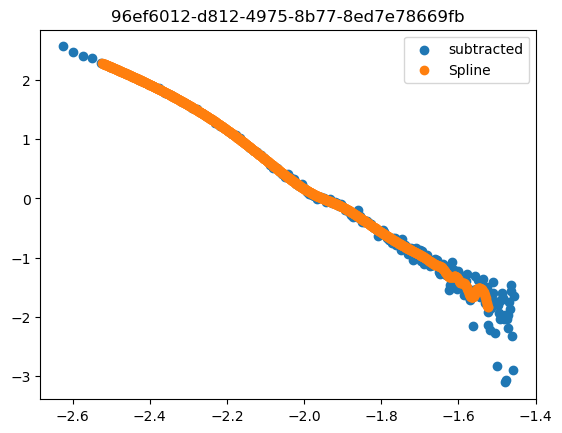

...

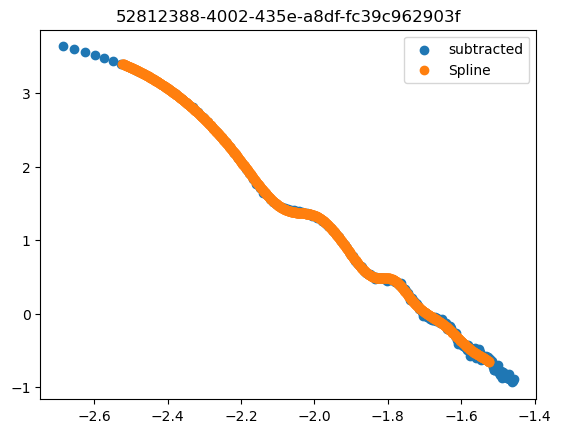

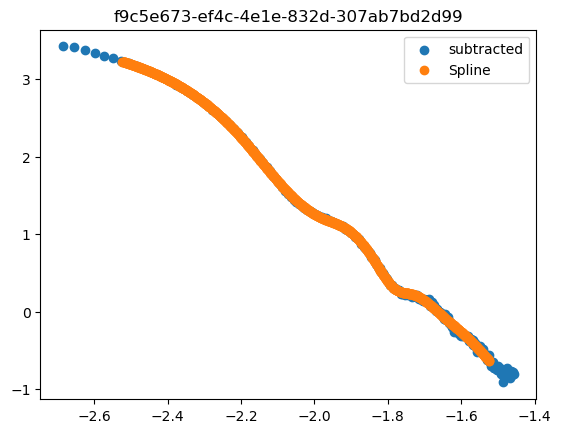

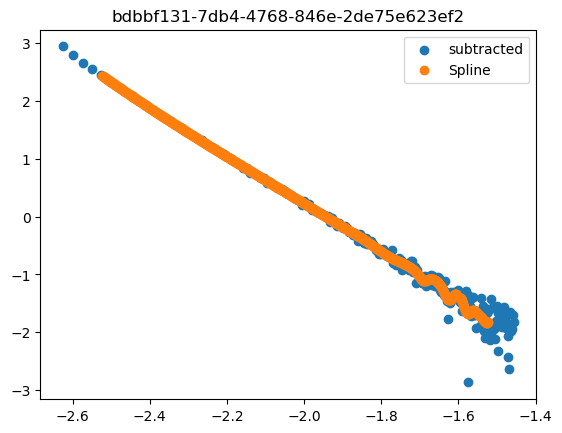

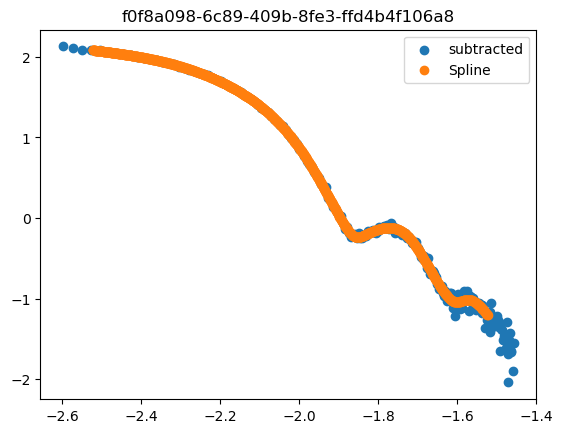

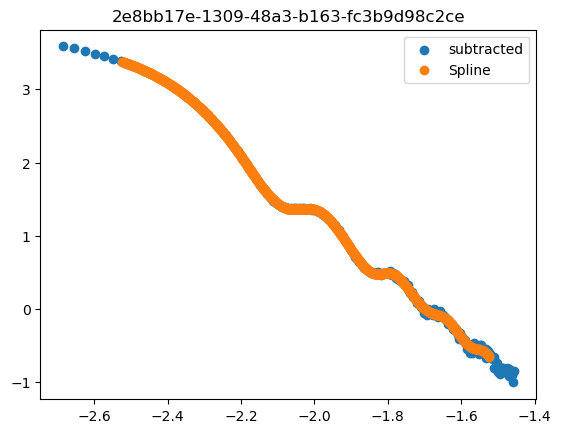

In [15]:
for uuid_val, entry in processing_dataset.items():
    try:
        status = entry['status']
        if status == 'failed':
            continue
        else:
            raise KeyError
    except KeyError:
        fig, ax = plt.subplots()
    
        I_subtracted = entry['I_log']
        q = entry['q_log']

        I_spline = entry['I_spline']
        
    
        ax.scatter(q, I_subtracted, label = 'subtracted')
        ax.scatter(q_grid, I_spline, label = 'Spline')
        ax.legend()
        ax.set_title(uuid_val)

## Sanity check scaling

/tmp/ipykernel_13591/1900914898.py:9: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig, ax = plt.subplots()


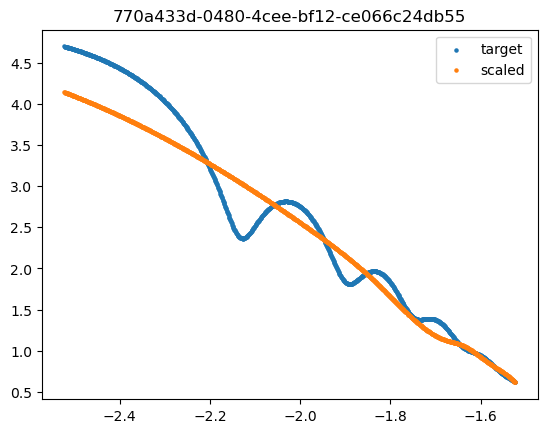

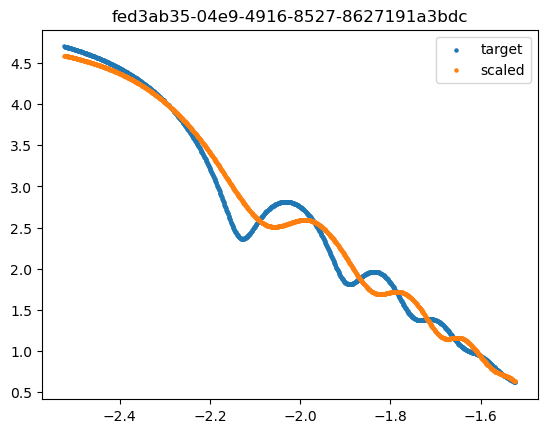

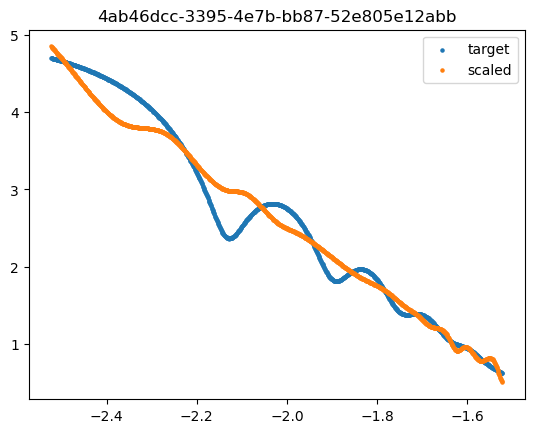

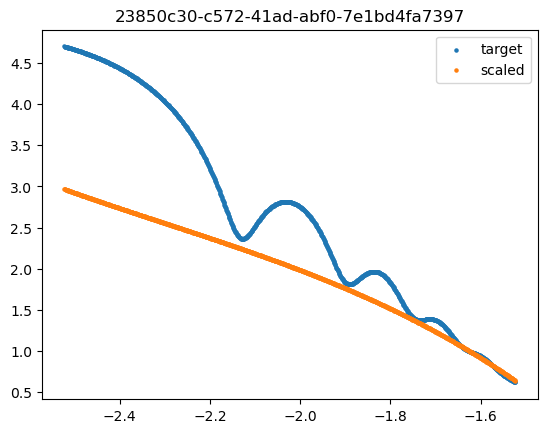

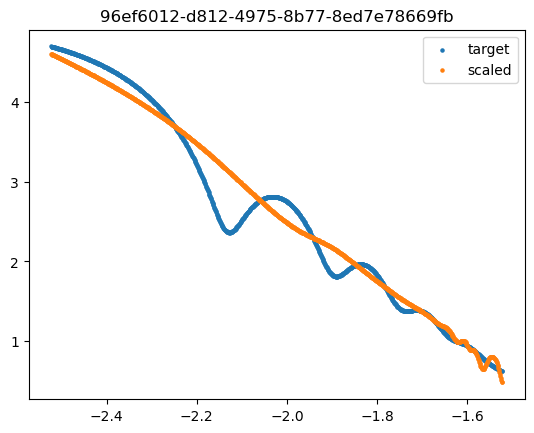

...

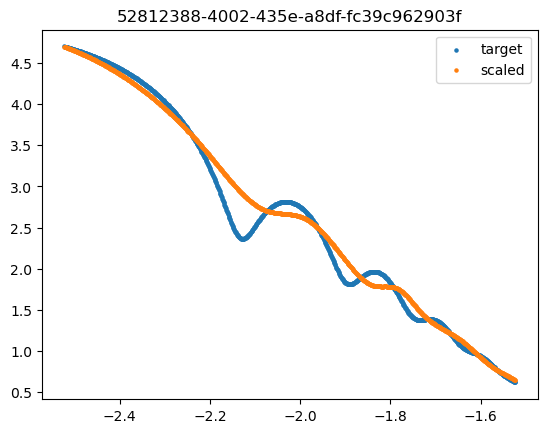

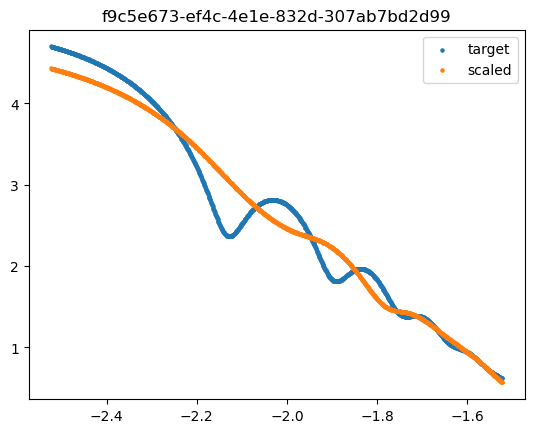

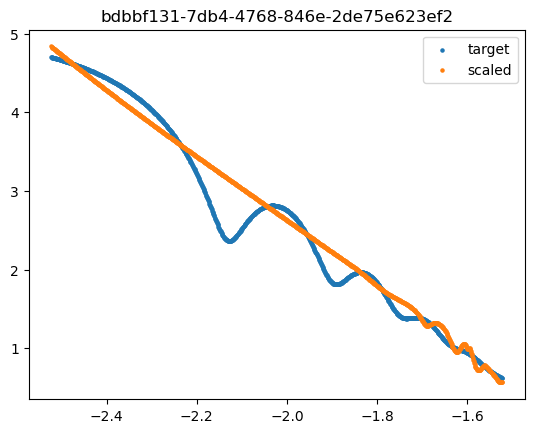

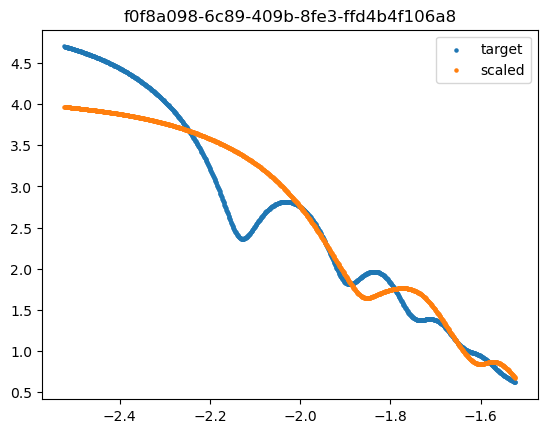

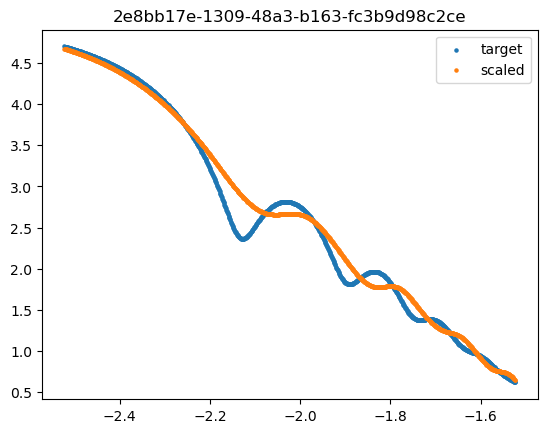

In [16]:
for uuid_val, entry in processing_dataset.items():
    try:
        status = entry['status']
        if status == 'failed':
            continue
        else:
            raise KeyError
    except KeyError:
        fig, ax = plt.subplots()


        I_scaled = entry['I_scaled']
        
    
        ax.scatter(q_grid, target_I, label = 'target', s = 5)
        ax.scatter(q_grid, I_scaled, label = 'scaled', s = 5)
        ax.legend()
        ax.set_title(uuid_val)

## Fit sphere model

In [32]:
for uuid_val, entry in processing_dataset.items():
    if uuid_val == 'a6ee3a08-02cd-4703-9d6c-3721dad590c8': 
        try:
            subtracted = entry['subtracted_clipped']
        except KeyError:
            continue
            
        data_sas = io.df_to_sasdata(subtracted)
        results, result_obj, problem  = sasview_fitting.fit_sphere(data_sas, polydispersity=True)
    
        processing_dataset[uuid_val]['sphere_fit_results'] = results
        processing_dataset[uuid_val]['sphere_fit_problem'] = problem

In [33]:
diameters = {}
pdi_vals = {}

for uuid_val, entry in processing_dataset.items():
    try:
        sphere_results = entry['sphere_fit_results']
        d = sphere_results['radius']*2/10
        pdi = sphere_results['radius_pd']
        diameters[uuid_val] = d
        pdi_vals[uuid_val] = pdi
    except KeyError:
        continue

In [43]:
processing_dataset

{'a6ee3a08-02cd-4703-9d6c-3721dad590c8': {'original_data':             q             I          sig
  0    0.000076  9.023793e+06  1978.310009
  1    0.000229  8.430744e+06  1352.127805
  2    0.000382  7.020598e+06   780.372266
  3    0.000535  5.424133e+06   685.930224
  4    0.000688  4.054448e+06   501.206414
  ..        ...           ...          ...
  900  0.137607  0.000000e+00     0.201118
  901  0.137760  0.000000e+00     0.156426
  902  0.137913  0.000000e+00     0.234640
  903  0.138066  0.000000e+00     0.469281
  904  0.138219  0.000000e+00     0.469283
  
  [905 rows x 3 columns],
  'background':             q             I          sig
  0    0.000076  9.279254e+06  2031.996565
  1    0.000229  8.654451e+06  1387.622024
  2    0.000382  7.190303e+06   799.935612
  3    0.000535  5.507749e+06   700.113609
  4    0.000688  4.121778e+06   521.262970
  ..        ...           ...          ...
  900  0.137607  0.000000e+00     0.186223
  901  0.137760  0.000000e+00     0.2128

In [34]:
diameters_dist = {uuid_val:np.abs(d-120) for uuid_val, d in diameters.items()}

In [35]:
min_dist = np.min(list(diameters_dist.values()))
min_uuid_d = [val for val in diameters_dist.keys() if diameters_dist[val] == min_dist][0]

In [36]:
min_uuid_d

'a6ee3a08-02cd-4703-9d6c-3721dad590c8'

In [37]:
diameters_dist[min_uuid_d]

np.float64(568.0190488796304)

In [38]:
min_pdi = np.sort(list(pdi_vals.values()))[1]
min_uuid_pdi = [val for val in pdi_vals.keys() if pdi_vals[val] == min_pdi][0]

IndexError: index 1 is out of bounds for axis 0 with size 1

In [39]:
min_uuid_pdi

NameError: name 'min_uuid_pdi' is not defined

In [40]:
min_pdi

NameError: name 'min_pdi' is not defined

## sanity check fit results

In [41]:
for uuid_val, entry in processing_dataset.items():
    try:
        sphere_d = entry['sphere_fit_results']['radius']*2/10
        sphere_pdi = entry['sphere_fit_results']['radius_pd']
    
        problem = entry['sphere_fit_problem']
    except KeyError:
        continue

    for model in problem.models:
        data = model._data
        Icalc = model.Iq_calc

    fig, ax = plt.subplots()

    ax.loglog(data.x, data.y, label = 'measured')
    ax.loglog(data.x, Icalc, label = 'fit')
    ax.text(0.1, 0.05, f'Diameter: {sphere_d} nm, pdi: {sphere_pdi}', transform = ax.transAxes)

AttributeError: 'BaseFitProblem' object has no attribute 'models'

In [42]:
problem

## Plot final ranked order of best samples

In [19]:
sum_ap = {}
for uuid_val, entry in processing_dataset.items():
    try:
        
        status = entry['status']
        if status == 'failed':
            continue
        else:
            raise KeyError
            
    except KeyError:
        sum_ap[uuid_val] = entry['ap_sum_distance']


uuids = np.array(list(sum_ap.keys()))
rmses = list(sum_ap.values())
uuid_sorted_sum = uuids[np.argsort(rmses)]

In [20]:

with PdfPages('ranked_apdist_results.pdf') as pdf:
    for i, uuid_val in enumerate(uuid_sorted_sum):

        entry  = processing_dataset[uuid_val]
        I_scaled = entry['I_scaled']
        
        distance = sum_ap[uuid_val]

        sphere_d = entry['sphere_fit_results']['radius']*2/10
        sphere_pdi = entry['sphere_fit_results']['radius_pd']


    
        fig, ax = plt.subplots()
        ax.loglog(10**q_grid, 10**target_I, label = 'target')
        ax.loglog(10**q_grid, 10**I_scaled, label = 'measured')
        ax.set_xlabel('q [1/A]')
        ax.set_title(uuid_val)
        ax.text(0.1, 0.1, f'Rank: {i}\nsum distance: {distance:.2f}\nsphere diameter: {sphere_d:.2f} nm\nsphere pdi: {sphere_pdi:.2f}', transform = ax.transAxes)
        ax.legend()
        pdf.savefig()
        plt.close()

## Write results to disk

In [21]:
uuid_vals = []
amplitude = []
phase = []
sum_ap = []
statuses = []
sphere_diameter = []
sphere_pdi = []

for uuid_val, entry in processing_dataset.items():
    try:
        status = entry['status']
        if status == 'failed':
            uuid_vals.append(uuid_val)
            amplitude.append(None)
            phase.append(None)
            sum_ap.append(None)
            statuses.append('failed')
            sphere_diameter.append(None)
            sphere_pdi.append(None)
            continue
        else:
            raise KeyError
    except KeyError:
        uuid_vals.append(uuid_val)
        amplitude.append(entry['amplitude_distance'])
        phase.append(entry['phase_distance'])
        sum_ap.append(entry['ap_sum_distance'])
        statuses.append('success')
        sphere_diameter.append(entry['sphere_fit_results']['radius']*2/10)
        sphere_pdi.append(entry['sphere_fit_results']['radius_pd'])
    

In [22]:
results_df = pd.DataFrame({'uuid':uuid_vals, 'amplitude_distance':amplitude, 'phase_distance':phase, 'sum_ap_distance':sum_ap, 'sphere_diameter_nm':sphere_diameter, 'sphere_pdi':sphere_pdi, 'processes_status':statuses})

In [23]:
#results_df.to_csv('amplitude_phase_results_afterOptimRound3_11_18_24.csv')

In [24]:
results_df

,uuid,amplitude_distance,phase_distance,sum_ap_distance,sphere_diameter_nm,sphere_pdi,processes_status
0,770a433d-0480-4cee-bf12-ce066c24db55,1.079610,0.407451,1.487061,47.474161,0.591172,success
1,fed3ab35-04e9-4916-8527-8627191a3bdc,0.474113,0.177540,0.651653,107.459643,0.132383,success
2,4ab46dcc-3395-4e7b-bb87-52e805e12abb,0.979413,0.540022,1.519435,66.709556,1.000000,success
3,23850c30-c572-41ad-abf0-7e1bd4fa7397,1.176489,0.445089,1.621578,21.500925,0.559668,success
4,96ef6012-d812-4975-8b77-8ed7e78669fb,1.003274,0.520217,1.523491,67.307375,0.567666,success
...,...,...,...,...,...,...,...
195,52812388-4002-435e-a8df-fc39c962903f,0.862854,0.362438,1.225292,110.693149,0.209575,success
196,f9c5e673-ef4c-4e1e-832d-307ab7bd2d99,0.969198,0.389132,1.358330,84.371104,0.285823,success
197,bdbbf131-7db4-4768-846e-2de75e623ef2,0.891382,0.566166,1.457548,95.618349,0.710525,success
198,f0f8a098-6c89-409b-8fe3-ffd4b4f106a8,0.873402,0.415012,1.288413,41.262376,0.503742,success
